# longyearbyen_test

In [1]:
%load_ext autoreload
%autoreload 2
from oogeso.io import file_io
import oogeso.plots as plots
from oogeso.utils import create_time_series_data
import oogeso.dto
import matplotlib.pyplot as plt
import IPython.display
#import numpy as np
import os
import pandas as pd
import logging
import pprint
import ipywidgets
import pickle
import plotly.express as px
import pyomo.environ as pyo
from dataclasses import asdict

logging.basicConfig()
logger = logging.getLogger()
logger.setLevel('INFO') #INFO

## Read input data

In [2]:
"""Select case"""

#case="_diesel_only_2018"
#case="_diesel_battery_2018"
#case="_diesel_battery_pv_2018"
#case="_diesel_battery_pv_eb_2018"
#case="_br_onshore_small_2018"
#case="_br_onshore_full_2018"
#case="_ir_offshore_limited_2018"
#case="_ir_offshore_full_2018"
case="_br_fully_renewable_2018"


"""Run, Save or load"""

run_case = True
save_case = True
load_case = False
recalculate_profiles = False
short = False # Only do two weeks
if not run_case and not load_case:
    raise Exception("At least one of run_case and load_case must be True.")
if save_case and not run_case:
    raise Exception("When save_case is True, run_case must also be True.")


"""Output location and input data file"""

outpath = "result/"
data = file_io.read_data_from_yaml("../tests/test_data/longyearbyen_test.yaml")

In [3]:
# Define lists of device, edge, and node names defined in the input data file
elloaddevices = ['el_load']
heatloaddevices = ['heat_load']
loaddevices = elloaddevices + heatloaddevices
eldumpdevices = ['el_dump']
heatdumpdevices = ['heat_dump']
dumpdevices = eldumpdevices + heatdumpdevices
dieselgenerators = ['backup_east_1','backup_east_2','backup_east_3','backup_west_1','backup_west_2','backup_west_3']
dieselboilers = ['diesel_boiler_1','diesel_boiler_2','boiler_houses']
dieselboilers_small = ['boiler_houses']
diesel_source = ["diesel_source"]
dieseldevices = dieselgenerators + dieselboilers + diesel_source + ['el_diesel_load', 'heat_diesel_load', 'diesel_backup']
powersupplydevices = ["powersupply", "el_ps_load", "heat_ps_load"]
batterydevices = ["el_storage"]
wind_turbines = ["wind"]
winddevices = wind_turbines + ["wind_farm", "el_wf_ps"]
pvdevices = ["pv", "el_pv_ps"]
electricboilerdevices = ["electric_boiler", "el_ps_eb", "heat_eb_load"]
geothermaldevices = ["geothermal", "el_ps_geo", "heat_geo_load"]
hydrogenelectrolyser = ['electrolyser']
hydrogenfuelcell = ['fuelcell']
hydrogenstorage = ['h2_storage']
hydrogendevices = hydrogenelectrolyser + hydrogenfuelcell + hydrogenstorage + ['el_ps_h2','heat_h2_load']

In [4]:
# Create dictionary with names that will be displayed in the flow graphs
pretty_name_dict = dict()
pretty_name_dict["el"] = "El"
pretty_name_dict["heat"] = "Heat"
pretty_name_dict["sourceel"] = "Source: el"
pretty_name_dict["sourceheat"] = "Source: heat"
pretty_name_dict["sinkel"] = "Sink: el"
pretty_name_dict["sinkheat"] = "Sink: heat"
pretty_name_dict["load"] = "Load"
pretty_name_dict["el_load"] = "El load"
pretty_name_dict["heat_load"] = "Heat load"
pretty_name_dict["el_dump"] = "El dump"
pretty_name_dict["heat_dump"] = "Heat dump"
pretty_name_dict["diesel"] = "Diesel"
pretty_name_dict["diesel_backup"] = "Diesel backup"
pretty_name_dict["sourcediesel"] = "Source: diesel"
pretty_name_dict["dieselgenerator"] = "Diesel generator"
pretty_name_dict["dieselheater"] = "Diesel boiler"
for i in range(1,4):
    pretty_name_dict["backup_east_" + str(i)] = "Backup East " + str(i)
    pretty_name_dict["backup_west_" + str(i)] = "Backup West " + str(i)
    if i < 3:
        pretty_name_dict["diesel_boiler_" + str(i)] = "Diesel boiler " + str(i)
pretty_name_dict["boiler_houses"] = "Boiler houses"
pretty_name_dict["diesel_source"] = "Diesel source"
pretty_name_dict["powersupply"] = "Power supply"
pretty_name_dict["el_storage"] = "Battery"
pretty_name_dict["storageel"] = "Storage: el"
pretty_name_dict["wind_farm"] = "Wind farm"
pretty_name_dict["wind"] = "Wind"
pretty_name_dict["pv"] = "PV"
pretty_name_dict["heatpump"] = "Heat pump"
pretty_name_dict["electric_boiler"] = "Electric boiler"
pretty_name_dict["geothermal"] = "Geothermal"
pretty_name_dict["hydrogen"]  = "<H<SUB>2</SUB>>"
pretty_name_dict["h2_storage"] = "Hydrogen storage"
pretty_name_dict["storagehydrogencompressor"] = "Storage: compressed H<SUB>2</SUB>"
pretty_name_dict["electrolyser"] = "Electrolyser"
pretty_name_dict["fuelcell"] = "Fuel cell"

In [5]:
"""Global model parameters"""

data.parameters.time_delta_minutes = 60 # minutes per timestep
data.parameters.planning_horizon = 240 # timesteps in each rolling optimisation
data.parameters.optimisation_timesteps = 24 # timesteps between each optimisation
data.parameters.forecast_timesteps = 24 # timesteps beyond which forecast (instead of nowcast) profile is used (forecast and nowcast are currently identical)
#time_reserve_minutes: 1440 # minutes, how long stored energy must be sustained to count as reserve
data.parameters.co2_tax = 2 # NOK/kgCO2 https://www.regjeringen.no/contentassets/4eeae826fa5c4e21ad186eec1d9b7873/no/pdfs/prp202120220001ls1dddpdfs.pdf
data.parameters.emission_intensity_max = -1 # kgCO2/Sm3oe, -1=no limit
data.parameters.emission_rate_max = -1 # kgCO2/hour, -1=no limit
data.parameters.objective = "costs" # select objective function to use

In [6]:
"""Cost and technology data based mainly on the Danish Energy Agency technology data sheet"""

euro_inflation_2015_2022 = 1.127
euro_inflation_2019_2022 = 1.087
euro_inflation_2020_2022 = 1.080
NOK_per_euro = 10.0
dollar_inflation_2013_2022 = 1.221
dollar_inflation_2018_2022 = 1.134
NOK_per_dollar = 8.81
NOK_inflation_2020_2022 = 1.0584
seconds_per_year = 3600 * 24 * 365
diesel_hhv_lhv_ratio = 1.063
h2_kWh_per_Nm3 = 12.7 / 3.6

# Diesel costs
diesel_fuel_cost = 7590 * NOK_inflation_2020_2022 # NOK/Nm3
diesel_generator_investment_cost = 0 # Already installed
diesel_generator_fixed_op_cost = 8800/seconds_per_year * euro_inflation_2015_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
diesel_generator_op_cost = 6/3600 * euro_inflation_2015_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs
diesel_generator_lifetime = 20 # years
diesel_boiler_investment_cost = 0 # Already installed
diesel_boiler_fixed_op_cost = 1800/seconds_per_year * euro_inflation_2019_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
diesel_boiler_op_cost = 1/3600 * euro_inflation_2019_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs
diesel_boiler_lifetime = 25 # years
diesel_boiler_eta = 0.94 / diesel_hhv_lhv_ratio # efficiency (hhv)
diesel_boiler_small_eta = 0.92 / diesel_hhv_lhv_ratio # efficiency (hhv)

# Battery costs
battery_investment_cost = 0 # Already installed (soon)
battery_fixed_op_cost = 540 / seconds_per_year * euro_inflation_2015_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
battery_op_cost = 2/3600 * euro_inflation_2015_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs
battery_lifetime = 20 # years
battery_eta = 0.91 # efficiency

# Onshore wind costs
onshore_wind_investment_cost = 1.04 * 10**6 * euro_inflation_2015_2022 * NOK_per_euro # M€/MW * €/M€ * inflation(€) * NOK/€ => NOK/MW
onshore_wind_fixed_op_cost = 12600/seconds_per_year * euro_inflation_2015_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
onshore_wind_op_cost = 1.35/3600 * euro_inflation_2015_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs
onshore_wind_lifetime = 30 # years

# Offshore wind costs
offshore_wind_investment_cost = 1.80 * 10**6 * euro_inflation_2020_2022 * NOK_per_euro # M€/MW * €/M€ * inflation(€) * NOK/€ => NOK/MW
offshore_wind_fixed_op_cost = 39000/seconds_per_year * euro_inflation_2020_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
offshore_wind_op_cost = 3.9/3600 * euro_inflation_2020_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs
offshore_wind_lifetime = 30 # years

# Photovoltaic costs
pv_investment_cost = 0.57 * 10**6 * euro_inflation_2020_2022 * NOK_per_euro # M€/MW * €/M€ * inflation(€) * NOK/€ => NOK/MW
pv_fixed_op_cost = 8900/seconds_per_year * euro_inflation_2020_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
pv_op_cost = 0/3600 * euro_inflation_2020_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs
pv_lifetime = 40 # years

# Electric boiler costs
eb_investment_cost = 0.14 * 10**6 * euro_inflation_2015_2022 * NOK_per_euro #M€/MW * €/M€ * inflation(€) * NOK/€ => NOK/MW
eb_fixed_op_cost = 1020/seconds_per_year * euro_inflation_2015_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
eb_op_cost = 0.5/3600 * euro_inflation_2015_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs (Not el costs)
eb_lifetime = 20 # years
eb_eta = 0.99 # efficiency

# Geothermal costs
geo_investment_cost = 2.69 * 10**6 * euro_inflation_2015_2022 * NOK_per_euro #M€/MW * €/M€ * inflation(€) * NOK/€ => NOK/MW
geo_fixed_op_cost = 22500/seconds_per_year * euro_inflation_2015_2022 * NOK_per_euro # €/(MW*year) / s/year * inflation(€) * NOK/€ => NOK/(MW*s)
geo_op_cost = 4.6/3600 * euro_inflation_2015_2022 * NOK_per_euro # €/MWh / s/h * inflation(€) * NOK/€ => NOK/MWs (Not el costs)
geo_lifetime = 40 # years
geo_eta = 4 # efficiency

# Hydrogen costs
h2_fuel_cell_investment_cost = 0.949 * 10**6 * dollar_inflation_2018_2022 * NOK_per_dollar #M$/MW * $/M$ * inflation($) * NOK/$ => NOK/MW
h2_fuel_cell_fixed_op_cost = 12800/seconds_per_year * dollar_inflation_2018_2022 * NOK_per_dollar # $/(MW*year) / s/year * inflation($) * NOK/$ => NOK/(MW*s)
h2_fuel_cell_op_cost = 0.5/3600 * dollar_inflation_2018_2022 * NOK_per_dollar # $/MWh / s/h * inflation($) * NOK/$ => NOK/MWs
h2_fuel_cell_lifetime = 30 # years
h2_fuel_cell_eta = 0.5 # 50 % of energy converted to electricity
h2_fuel_cell_eta_heat = 0.4 / (1 - h2_fuel_cell_eta) # % recovered total energy / amount of waste energy => % recovered waste energy
h2_electrolyser_investment_cost = 0.437 * 10**6 * dollar_inflation_2018_2022 * NOK_per_dollar #M$/MW * $/M$ * inflation($) * NOK/$ => NOK/MW
h2_electrolyser_fixed_op_cost = 12800/seconds_per_year * dollar_inflation_2018_2022 * NOK_per_dollar # $/(MW*year) / s/year * inflation($) * NOK/$ => NOK/(MW*s)
h2_electrolyser_op_cost = 0.5/3600 * dollar_inflation_2018_2022 * NOK_per_dollar # $/MWh / s/h * inflation($) * NOK/$ => NOK/MWs
h2_electrolyser_lifetime = 30 # years
h2_electrolyser_eta = 0.73 # Share of H2 HHV required for electrolysis
h2_electrolyser_eta_heat = 0.23 / (1 - h2_electrolyser_eta) # % recovered total energy / amount of waste energy => % recovered waste energy
h2_compressorstorage_investment_cost = 1 * h2_kWh_per_Nm3 * dollar_inflation_2013_2022 * NOK_per_dollar # $/kWh * kWh/Nm3 * inflation($) * NOK/$ => NOK/Nm3
h2_compressorstorage_fixed_op_cost = 0.01 * h2_compressorstorage_investment_cost / seconds_per_year # 1% of investment cost per year
h2_compressorstorage_op_cost = 0 # Zero variable operational costs
h2_compressorstorage_eta = 0.95 # motor efficiency
h2_compressorstorage_eta_heat = 0.9 # recovered energy difference between actual compreesion work and isothermal compression work
h2_compressorstorage_isothermal_adiabatic = 0.5 # actual compression work is this share of isothermal and (1 - this share) of adiabatic
h2_compressorstorage_p_in = 3 # MPa (30 bar). pressure of input hydrogen
h2_compressorstorage_temperature = 300 # Kelvin
h2_compressorstorage_p_max = 70 # MPa (700 bar)
h2_compressorstorage_lifetime = 20 # years

In [7]:
# Initially include no devices
incl_diesel=False
incl_battery=False
incl_wind=False
incl_pv=False
incl_electricboiler=False
incl_geothermal=False
incl_hydrogen=False

if case=="_diesel_only_2018":
    # Add included devices
    incl_diesel=True
    # Combine profiles
    if recalculate_profiles or not os.path.exists('../tests/test_data/profiles'+case+'.csv'):
        load = pd.read_csv('../tests/test_data/LYR_load.csv')
        load.set_index(load["timestamp"], inplace=True)
        load = load['2018-01-01':]
        load.fillna(0,inplace=True)
        load.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    else:
        load = pd.read_csv('../tests/test_data/profiles'+case+'.csv')
    # Define timerange
    timerange = [0,min(24*365,len(load)-data.parameters.planning_horizon)]
    # Set the reserve margin requirement to 0 to make the problem feasible
    for carrier in data.carriers:
        if carrier.id == "el":
            carrier.el_reserve_margin = 0

if case=="_diesel_battery_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    # Combine profiles
    if recalculate_profiles or not os.path.exists('../tests/test_data/profiles'+case+'.csv'):
        load = pd.read_csv('../tests/test_data/LYR_load.csv')
        load.set_index(load["timestamp"], inplace=True)
        load = load['2018-01-01':]
        load.fillna(0,inplace=True)
        load.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    else:
        load = pd.read_csv('../tests/test_data/profiles'+case+'.csv')
    # Define timerange
    timerange = [0,min(24*365,len(load)-data.parameters.planning_horizon)]
    # Set the reserve margin requirement to 0 to make the problem feasible
    for carrier in data.carriers:
        if carrier.id == "el":
            carrier.el_reserve_margin = 0

if case=="_diesel_battery_pv_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    incl_pv=True
    # Combine profiles
    if recalculate_profiles or not os.path.exists('../tests/test_data/profiles'+case+'.csv'):
        first = pd.read_csv('../tests/test_data/LYR_load.csv')
        second = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
        merged = pd.merge(first, second, how='left', on='timestamp')
        merged.set_index(merged["timestamp"], inplace=True)
        merged = merged['2018-01-01':]
        merged.fillna(0,inplace=True)
        merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    else:
        merged = pd.read_csv('../tests/test_data/profiles'+case+'.csv')
    # Define timerange
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    # Set PV values
    pv_P_max=25 # MWp, Sun on all roofs
    pv_P_min=0 # MWp, Allow not producing all PV, as there's no long term storage option
    pv_profile="PV" # Sun profile
    # Set the reserve margin requirement to 0 to make the problem feasible
    # for carrier in data.carriers:
    #     if carrier.id == "el":
    #         carrier.el_reserve_margin = 0

if case=="_diesel_battery_pv_eb_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    incl_pv=True
    incl_electricboiler=True
    # Combine profiles
    if recalculate_profiles or not os.path.exists('../tests/test_data/profiles'+case+'.csv'):
        first = pd.read_csv('../tests/test_data/LYR_load.csv')
        second = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
        merged = pd.merge(first, second, how='left', on='timestamp')
        merged.set_index(merged["timestamp"], inplace=True)
        merged = merged['2018-01-01':]
        merged.fillna(0,inplace=True)
        merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    else:
        merged = pd.read_csv('../tests/test_data/profiles'+case+'.csv')
    # Define timerange
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    # Set PV values
    pv_P_max=25 # MWp, Sun on all roofs
    pv_P_min=0 # MWp, Allow not producing all PV, as there's no long term storage option
    pv_profile="PV" # Sun profile
    # Set the reserve margin requirement to 0 to make the problem feasible
    # for carrier in data.carriers:
    #     if carrier.id == "el":
    #         carrier.el_reserve_margin = 0

elif case=="_br_onshore_small_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    incl_wind=True
    incl_pv=True
    incl_electricboiler=True
    #incl_geothermal=True
    # Combine profiles
    if recalculate_profiles or not os.path.exists('../tests/test_data/profiles'+case+'.csv'):
        first = pd.read_csv('../tests/test_data/LYR_load.csv')
        second = pd.read_csv('../tests/test_data/cap_factors_1hr_br_log.csv')
        third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
        #fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
        merged = pd.merge(first, second, how='left', on='timestamp')
        merged = pd.merge(merged, third, how='left', on='timestamp')
        #merged = pd.merge(merged, fourth, how='left', on='timestamp')
        merged.set_index(merged["timestamp"], inplace=True)
        merged = merged['2018-01-01':]
        merged.fillna(0,inplace=True)
        merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    else:
        merged = pd.read_csv('../tests/test_data/profiles'+case+'.csv')
    # Define timerange
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    # Set wind values
    wind_P_max=3.45*5 # MW, 5 Vestas V105 turbines
    wind_P_min=0 # MW, Allow not producing all wind output, as there's no long term storage option
    wind_profile="V105" # wind profile name with Breinosa data
    wind_investment_cost = onshore_wind_investment_cost
    wind_fixed_op_cost = onshore_wind_fixed_op_cost
    wind_op_cost = onshore_wind_op_cost
    wind_lifetime = onshore_wind_lifetime
    # Set PV values
    pv_P_max=25 # MWp, Sun on all roofs
    pv_P_min=0 # MWp, Allow not producing all PV, as there's no long term storage option
    pv_profile="PV" # Sun profile
    # Set electric boiler values
    eb_P_max = 5 / eb_eta # el_input = heat_output / eta
    eb_P_min = 0
    # Set Geothermal values
    #geothermal_P_max=1.3 # Wintertime max electrical input power
    #geothermal_P_min=0 #  MW, geothermal can output the full range of 0 to P_max
    #geothermal_profile="geothermal"
    
elif case=="_br_onshore_full_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    incl_wind=True
    incl_pv=True
    incl_electricboiler=True
    incl_geothermal=True
    incl_hydrogen=True
    # Combine profiles
    if recalculate_profiles or not os.path.exists('../tests/test_data/profiles'+case+'.csv'):
        first = pd.read_csv('../tests/test_data/LYR_load.csv')
        second = pd.read_csv('../tests/test_data/cap_factors_1hr_br_log.csv')
        third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
        fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
        merged = pd.merge(first, second, how='left', on='timestamp')
        merged = pd.merge(merged, third, how='left', on='timestamp')
        merged = pd.merge(merged, fourth, how='left', on='timestamp')
        merged.fillna(0,inplace=True)
        merged.set_index(merged["timestamp"], inplace=True)
        merged = merged['2018-01-01':]
        merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    else:
        merged = pd.read_csv('../tests/test_data/profiles'+case+'.csv')
    # Define timerange
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    # Set wind values
    wind_P_max=3.45*10 # MW, 10 Vestas V105 turbines
    wind_P_min=wind_P_max # MW, Force full production to fill storage when possible (the forecast is not long enough to always justify full production as there's a variable op_cost)
    wind_profile="V105" # wind profile name with Breinosa data
    wind_investment_cost = onshore_wind_investment_cost
    wind_fixed_op_cost = onshore_wind_fixed_op_cost
    wind_op_cost = onshore_wind_op_cost
    wind_lifetime = onshore_wind_lifetime
    # Set PV values
    pv_P_max=25 # MWp, Sun on all roofs
    pv_P_min=pv_P_max # MW, Force full production to fill storage when possible (the forecast is not long enough to always justify full production as there's a variable op_cost)
    pv_profile="PV" # Sun profile
    # Set electric boiler values
    eb_P_max = 5 / eb_eta # el_input = heat_output / eta
    eb_P_min = 0
    # Set Geothermal values
    geothermal_P_max=1.3 # Wintertime max electrical input power
    geothermal_P_min=0 #  MW, geothermal can output the full range of 0 to P_max
    geothermal_profile="geothermal"
    # Set hydrogen system values
    h2_electrolyser_flow_max = 40 # MW installed capacity
    h2_fuel_cell_flow_max = 10 # MW installed capacity
    h2_compressorstorage_E_max = 0.8*10**6 # 1 million Nm3
    h2_compressorstorage_E_init = 3*10**5 # 300 000 Nm3

elif case=="_ir_offshore_limited_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    incl_wind=True
    incl_pv=True
    incl_electricboiler=True
    incl_geothermal=True
    incl_hydrogen=True
    # Combine profiles
    if recalculate_profiles or not os.path.exists('../tests/test_data/profiles'+case+'.csv'):
        first = pd.read_csv('../tests/test_data/LYR_load.csv')
        second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir_log.csv')
        third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
        fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
        merged = pd.merge(first, second, how='left', on='timestamp')
        merged = pd.merge(merged, third, how='left', on='timestamp')
        merged = pd.merge(merged, fourth, how='left', on='timestamp')
        merged.set_index(merged["timestamp"], inplace=True)
        merged = merged['2018-01-01':]
        merged.fillna(0,inplace=True)
        merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    else:
        merged = pd.read_csv('../tests/test_data/profiles'+case+'.csv')
    # Define timerange
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    # Set wind values
    wind_P_max=3.45*5 # MW, 5 Vestas V105 turbines
    wind_P_min=wind_P_max # MW, Force full production to fill storage when possible (the forecast is not long enough to always justify full production as there's a variable op_cost)
    wind_profile="V105" # wind profile name with Isfjord radio data
    wind_investment_cost = offshore_wind_investment_cost
    wind_fixed_op_cost = offshore_wind_fixed_op_cost
    wind_op_cost = offshore_wind_op_cost
    wind_lifetime = offshore_wind_lifetime
    # Set PV values
    pv_P_max=25 # MWp, Sun on all roofs
    pv_P_min=pv_P_max # MW, Force full production to fill storage when possible (the forecast is not long enough to always justify full production as there's a variable op_cost)
    pv_profile="PV" # Sun profile
    # Set electric boiler values
    eb_P_max = 5 / eb_eta # el_input = heat_output / eta
    eb_P_min = 0
    # Set geothermal values
    geothermal_P_max=1.3 # MW, Wintertime input power
    geothermal_P_min=0 #  MW, geothermal can output the full range of 0 to P_max
    geothermal_profile="geothermal"
    # Set hydrogen system values
    h2_electrolyser_flow_max = 25 # MW installed capacity
    h2_fuel_cell_flow_max = 10 # MW installed capacity
    h2_compressorstorage_E_max = 0.6*10**6 # 0.6 million Nm3
    h2_compressorstorage_E_init = 0.005*10**6 # 5000 Nm3

elif case=="_ir_offshore_full_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    incl_wind=True
    incl_pv=True
    incl_electricboiler=True
    incl_geothermal=True
    incl_hydrogen=True
    # Combine profiles
    if recalculate_profiles or not os.path.exists('../tests/test_data/profiles'+case+'.csv'):
        first = pd.read_csv('../tests/test_data/LYR_load.csv')
        second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir_log.csv')
        third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
        fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
        merged = pd.merge(first, second, how='left', on='timestamp')
        merged = pd.merge(merged, third, how='left', on='timestamp')
        merged = pd.merge(merged, fourth, how='left', on='timestamp')
        merged.set_index(merged["timestamp"], inplace=True)
        merged = merged['2018-01-01':]
        merged.fillna(0,inplace=True)
        merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    else:
        merged = pd.read_csv('../tests/test_data/profiles'+case+'.csv')
    # Define timerange
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    # Set wind values
    wind_P_max=3.45*7 # MW, 7 Vestas V105 turbines
    wind_profile="V105" # wind profile name with Isfjord radio data
    wind_investment_cost = offshore_wind_investment_cost
    wind_fixed_op_cost = offshore_wind_fixed_op_cost
    wind_op_cost = offshore_wind_op_cost
    wind_lifetime = offshore_wind_lifetime
    # Set PV values
    pv_P_max=25 # MWp, Sun on all roofs
    pv_P_min=pv_P_max # MW, Force full production to fill storage when possible (the forecast is not long enough to always justify full production as there's a variable op_cost)
    wind_P_min=wind_P_max # MW, Force full production to fill storage when possible (the forecast is not long enough to always justify full production as there's a variable op_cost)
    pv_profile="PV" # Sun profile
    # Set electric boiler values
    eb_P_max = 5 / eb_eta # el_input = heat_output / eta
    eb_P_min = 0
    # Set geothermal values
    geothermal_P_max=1.3 # Wintertime input power
    geothermal_P_min=0 #  MW, geothermal can output the full range of 0 to P_max
    geothermal_profile="geothermal"
    # Set hydrogen system values
    h2_electrolyser_flow_max = 35 # MW installed capacity
    h2_fuel_cell_flow_max = 10 # MW installed capacity
    h2_compressorstorage_E_max = 1.75*10**6 # 1.75 million Nm3
    h2_compressorstorage_E_init = 0.3*10**6 # 300 000 Nm3

elif case=="_br_fully_renewable_2018":
    # Add included devices
    incl_diesel=True
    incl_battery=True
    incl_wind=True
    incl_pv=True
    incl_electricboiler=True
    incl_geothermal=True
    incl_hydrogen=True
    # Combine profiles
    if recalculate_profiles or not os.path.exists('../tests/test_data/profiles'+case+'.csv'):
        first = pd.read_csv('../tests/test_data/LYR_load.csv')
        second = pd.read_csv('../tests/test_data/cap_factors_1hr_br_log.csv')
        third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
        fourth = pd.read_csv('../tests/test_data/geothermal_supply_1hr.csv')[["timestamp","geothermal"]]
        merged = pd.merge(first, second, how='left', on='timestamp')
        merged = pd.merge(merged, third, how='left', on='timestamp')
        merged = pd.merge(merged, fourth, how='left', on='timestamp')
        merged.set_index(merged["timestamp"], inplace=True)
        merged = merged['2018-01-01':]
        merged.fillna(0,inplace=True)
        merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    else:
        merged = pd.read_csv('../tests/test_data/profiles'+case+'.csv')
    # Define timerange
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    # Set wind values
    wind_P_max=3.45*15 # MW, 15 Vestas V105 turbines
    wind_P_min=wind_P_max # MW, Force full production to fill storage when possible (the forecast is not long enough to always justify full production as there's a variable op_cost)
    wind_profile="V105" # wind profile name with Breinosa data
    wind_investment_cost = onshore_wind_investment_cost
    wind_fixed_op_cost = onshore_wind_fixed_op_cost
    wind_op_cost = onshore_wind_op_cost
    wind_lifetime = onshore_wind_lifetime
    # Set PV values
    pv_P_max=25 # MWp, Sun on all roofs
    pv_P_min=pv_P_max # MW, Force full production to fill storage when possible (the forecast is not long enough to always justify full production as there's a variable op_cost)
    pv_profile="PV" # Sun profile
    # Set electric boiler values
    eb_P_max = 10 / eb_eta # el_input = heat_output / eta
    eb_P_min = 0
    # Set Geothermal values
    geothermal_P_max=1.3 # Wintertime max electrical input power
    geothermal_P_min=0 #  MW, geothermal can output the full range of 0 to P_max
    geothermal_profile="geothermal"
    # Set hydrogen system values
    h2_electrolyser_flow_max = 60 # MW installed capacity
    h2_fuel_cell_flow_max = 15 # MW installed capacity
    h2_compressorstorage_E_max = 5*10**6 # 4 million Nm3
    h2_compressorstorage_E_init = 3.5*10**6 # 2 million Nm3

# Create profiles
timeseries = file_io.read_profiles_from_csv(
    filename_forecasts="../tests/test_data/profiles"+case+".csv",
    dayfirst = False)
profiles = create_time_series_data(
    df_forecast=timeseries["forecast"],
    df_nowcast=timeseries["forecast"],
    time_start=None,time_end=None,
    timestep_minutes=60,
    resample_method="linear")
data.profiles = profiles

# Turn devices, edges, and nodes on or off, and initialize values
for dev in data.devices:
    if dev.id in dieseldevices:
        dev.include = incl_diesel
        if incl_diesel:
            if dev.id in dieselgenerators:
                dev.reserve_factor = 1
                dev.reserve_heat_factor = 1
                dev.investment_cost = diesel_generator_investment_cost
                dev.fixed_op_cost = diesel_generator_fixed_op_cost
                dev.op_cost = diesel_generator_op_cost
                dev.lifetime = diesel_generator_lifetime
            elif dev.id in dieselboilers:
                dev.reserve_factor = 0
                dev.reserve_heat_factor = 1
                dev.investment_cost = diesel_boiler_investment_cost
                dev.fixed_op_cost = diesel_boiler_fixed_op_cost
                dev.op_cost = diesel_boiler_op_cost
                dev.lifetime = diesel_boiler_lifetime
                if dev.id in dieselboilers_small:
                    dev.eta = diesel_boiler_small_eta
                else:
                    dev.eta = diesel_boiler_eta
            elif dev.id in diesel_source:
                dev.reserve_factor = 0
                dev.reserve_heat_factor = 0
                dev.op_cost = diesel_fuel_cost
    if dev.id in batterydevices:
        dev.include = incl_battery
        if incl_battery:
            dev.reserve_factor = 1
            dev.reserve_heat_factor = 0
            dev.investment_cost = battery_investment_cost
            dev.fixed_op_cost = battery_fixed_op_cost
            dev.op_cost_in = -1 * battery_op_cost
            dev.op_cost_out = 2 * battery_op_cost
            dev.lifetime = battery_lifetime
            dev.eta = battery_eta
    if dev.id in winddevices:
        dev.include = incl_wind
        if incl_wind:
            dev.reserve_factor = 0.5
            dev.reserve_heat_factor = 0
            dev.flow_max = wind_P_max
            dev.flow_min = wind_P_min
            dev.profile = wind_profile
            dev.investment_cost = wind_investment_cost
            dev.fixed_op_cost = wind_fixed_op_cost
            dev.op_cost = wind_op_cost
            dev.lifetime = wind_lifetime
    if dev.id in pvdevices:
        dev.include = incl_pv
        if incl_pv:
            dev.reserve_factor = 0.5
            dev.reserve_heat_factor = 0
            dev.flow_max = pv_P_max
            dev.flow_min = pv_P_min
            dev.profile = pv_profile
            dev.investment_cost = pv_investment_cost
            dev.fixed_op_cost = pv_fixed_op_cost
            dev.op_cost = pv_op_cost
            dev.lifetime = pv_lifetime
    if dev.id in electricboilerdevices:
        dev.include = incl_electricboiler
        if incl_electricboiler:
            dev.reserve_factor = 0
            dev.reserve_heat_factor = 1
            dev.flow_max = eb_P_max
            dev.flow_min = eb_P_min
            dev.investment_cost = eb_investment_cost
            dev.fixed_op_cost = eb_fixed_op_cost
            dev.op_cost = eb_op_cost
            dev.lifetime = eb_lifetime
            dev.eta = eb_eta
    if dev.id in geothermaldevices:
        dev.include = incl_geothermal
        if incl_geothermal:
            dev.reserve_factor = 0
            dev.reserve_heat_factor = 1
            dev.flow_max = geothermal_P_max
            dev.flow_min = geothermal_P_min
            dev.profile = geothermal_profile
            dev.investment_cost = geo_investment_cost
            dev.fixed_op_cost = geo_fixed_op_cost
            dev.op_cost = geo_op_cost
            dev.lifetime = geo_lifetime
            dev.eta = geo_eta
    if dev.id in hydrogendevices:
        dev.include = incl_hydrogen
        if incl_hydrogen:
            if dev.id in hydrogenelectrolyser:
                dev.reserve_factor = 0
                dev.reserve_heat_factor = 0
                dev.flow_max = h2_electrolyser_flow_max
                dev.investment_cost = h2_electrolyser_investment_cost
                dev.fixed_op_cost = h2_electrolyser_fixed_op_cost
                dev.op_cost = h2_electrolyser_op_cost
                dev.lifetime = h2_electrolyser_lifetime
                dev.eta = h2_electrolyser_eta
                dev.eta_heat = h2_electrolyser_eta_heat
            if dev.id in hydrogenfuelcell:
                dev.reserve_factor = 1
                dev.reserve_heat_factor = 1
                dev.flow_max = h2_fuel_cell_flow_max
                dev.investment_cost = h2_fuel_cell_investment_cost
                dev.fixed_op_cost = h2_fuel_cell_fixed_op_cost
                dev.op_cost = h2_fuel_cell_op_cost
                dev.lifetime = h2_fuel_cell_lifetime
                dev.eta = h2_fuel_cell_eta
                dev.eta_heat = h2_fuel_cell_eta_heat
            if dev.id in hydrogenstorage:
                dev.reserve_factor = 0
                dev.reserve_heat_factor = 0
                dev.E_max = h2_compressorstorage_E_max
                dev.E_init = h2_compressorstorage_E_init
                dev.investment_cost = h2_compressorstorage_investment_cost
                dev.fixed_op_cost = h2_compressorstorage_fixed_op_cost
                dev.op_cost_in = -0.1 * h2_compressorstorage_op_cost - 1.1 * (wind_op_cost + h2_electrolyser_op_cost)
                dev.op_cost_out = 1.1 * h2_compressorstorage_op_cost + 1.1 * (wind_op_cost + h2_electrolyser_op_cost)
                dev.lifetime = h2_compressorstorage_lifetime
                dev.compressor.eta = h2_compressorstorage_eta
                dev.compressor.eta_heat = h2_compressorstorage_eta_heat
                dev.compressor.p_in = h2_compressorstorage_p_in
                dev.compressor.p_max = h2_compressorstorage_p_max
                dev.compressor.temperature = h2_compressorstorage_temperature
                dev.compressor.isothermal_adiabatic = h2_compressorstorage_isothermal_adiabatic
for edge in data.edges:
    if edge.id in dieseldevices:
        edge.include = incl_diesel
    if edge.id in powersupplydevices:
        edge.include = incl_wind or incl_battery or incl_pv or incl_geothermal or incl_hydrogen or incl_electricboiler
    if edge.id in winddevices:
        edge.include = incl_wind
    if edge.id in pvdevices:
        edge.include = incl_pv
    if edge.id in electricboilerdevices:
        edge.include = incl_electricboiler
    if edge.id in geothermaldevices:
        edge.include = incl_geothermal
    if edge.id in hydrogendevices:
        edge.include = incl_hydrogen
for node in data.nodes:
    if node.id in dieseldevices:
        node.include = incl_diesel
    if node.id in powersupplydevices:
        node.include = incl_wind or incl_pv or incl_battery or incl_geothermal or incl_hydrogen or incl_electricboiler
    if node.id in winddevices:
        node.include = incl_wind
    if node.id in pvdevices:
        node.include = incl_pv
    if node.id in electricboilerdevices:
        node.include = incl_electricboiler
    if node.id in geothermaldevices:
        node.include = incl_geothermal
    if node.id in hydrogendevices:
        node.include = incl_hydrogen

simulator = oogeso.Simulator(data)

In [8]:
devices = [dieselgenerators, dieselboilers, diesel_source, batterydevices, winddevices, pvdevices, electricboilerdevices, geothermaldevices, hydrogenelectrolyser, hydrogenfuelcell, hydrogenstorage, elloaddevices, heatloaddevices, eldumpdevices, heatdumpdevices]
device_colors = ["#000000", "#A52A2A", "#808080", "#7B0000", "#2ca02c", "#ff7f0e", "#e377c2", "#808000", "#636EFA", "#17becf", "#9467bd", "#FF0000", "#1a601a", "#ff6666", "#aad9aa"] # black, brown, gray, dark red, green, orange, pink, olive, blue-teal, purple, red, dark green, light red, light green
device_color_dict = dict()
for i in range(len(devices)):
    for j in range(len(devices[i])):
        device_color_dict[devices[i][j]] = device_colors[i]

In [9]:
for dev in data.devices:
    print(dev.id)

wind
pv
loadshed
el_load
heat_load
electrolyser
fuelcell
h2_storage
el_storage
geothermal
electric_boiler
heat_dump
el_dump
diesel_source
backup_east_1
backup_east_2
backup_east_3
backup_west_1
backup_west_2
backup_west_3
diesel_boiler_1
diesel_boiler_2
boiler_houses


In [10]:
# Test solve:
if run_case:
    simulator.optimiser.solve(solver="gurobi", time_limit=60)

### Inspect input data

In [10]:
@ipywidgets.interact(datagroup=['','devices','nodes','edges','carriers','parameters'])
def showdata(datagroup):
    pprint.pprint(data.dict()[datagroup],indent=1) if datagroup!='' else print('')

interactive(children=(Dropdown(description='datagroup', options=('', 'devices', 'nodes', 'edges', 'carriers', …

In [11]:
yy=['']+list(simulator.optimiser.component_objects(oogeso.optimiser.pyo.Constraint, active=True))
@ipywidgets.interact(constraint=yy)
def showdata(constraint):
    pprint.pprint(constraint.pprint(),width=1) if constraint!='' else print('')

interactive(children=(Dropdown(description='constraint', options=('', <pyomo.core.base.constraint.IndexedConst…

In [12]:
# View profiles (entire available time windows)
scale=300/96 # ratio print vs screen dpi
fig=plots.plot_profiles(profiles,filename=None)
#fig.update_layout(template="plotly_white",autosize=False,width=600,height=200,margin=dict(l=0,r=0,t=0,b=0))
fig.show()
#300 dpi and 4 inch: 1200 pixels
#fig.write_image(outpath+"profiles.pdf",width=600,height=200,scale=scale)

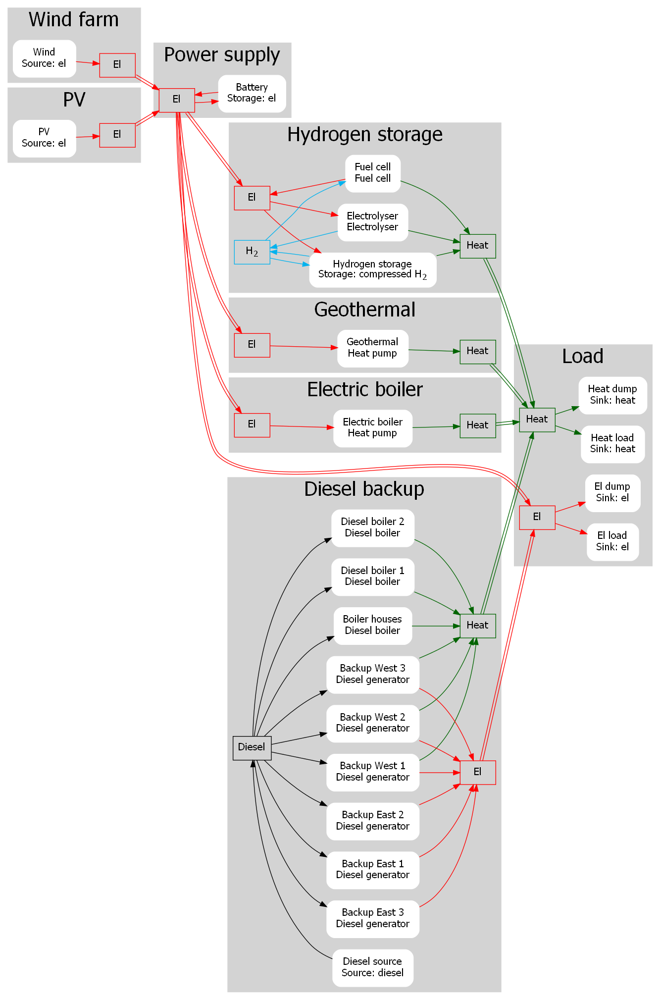

In [12]:
# View energy system
dotG=plots.plot_network(simulator,timestep=None,filename=None,rank_direction="LR",hide_edgelabel=True,only_carrier=None,fontsize=20,node_fs=30, dev_fs=15, edge_fs = 14, carrier_fs=15,fn = "DejaVu Sans", names = pretty_name_dict)#, exclude=[dev for dev in dieselgenerators + dieselboilers if dev not in ["boiler_houses", "backup_east_1","backup_east_2"]])
dotG.write_pdf(path=outpath+"diagram{}_noflow.pdf".format(case))
IPython.display.Image(dotG.create_png(prog="dot")) #scales automatically to page width

## Solve

If the problem is infeasible, try 
* add a high cost emergency generator (that could represent load shedding) to ensure energy balance can be satisfied
* make sure excess heat/electricity has a place to go

In [11]:
# Run the selected simulation case
if run_case:
    if short: timerange=[0,24*7*2]
    sim_result = simulator.run_simulation(solver="gurobi",time_range=timerange,write_yaml=False,time_limit=30)
    print("Mean CO2 emission rate      = {:.1f} kgCO2/s".format(sim_result.co2_rate.mean()))
    print("Mean CO2 emission intensity = {:.1f} kgCO2/Sm3oe".format(sim_result.co2_intensity.mean()))

100%|██████████| 355/355 [1:09:39<00:00, 11.77s/it]

Mean CO2 emission rate      = 0.0 kgCO2/s
Mean CO2 emission intensity = nan kgCO2/Sm3oe


In [13]:
if run_case: simulator.optimiser.write("test.mps",io_options = {"symbolic_solver_labels":True})

In [14]:
if run_case:
    # Remove negligible dump values (Less than 1 W)
    sim_result.device_flow["el_dump"]["el"]["in"][abs(sim_result.device_flow["el_dump"]["el"]["in"]) < 10**(-6)] = 0
    sim_result.device_flow["heat_dump"]["heat"]["in"][abs(sim_result.device_flow["heat_dump"]["heat"]["in"]) < 10**(-6)] = 0
    sim_result.op_cost_per_dev["el_dump"][sim_result.device_flow["el_dump"]["el"]["in"] == 0] = 0
    sim_result.op_cost_per_dev["heat_dump"][sim_result.device_flow["heat_dump"]["el"]["in"] == 0] = 0

## Save/Load simulation results
By saving to pickle file, it easy to later open and analyse the results without having to re-run the simulation

In [15]:
if run_case and save_case:
   pickle_save='{}case{}.pkl'.format(outpath,case)
   # Save (pickle) - for later opening and analysis
   dumpdata={"data":data,"result":sim_result}
   with open(pickle_save, mode='wb') as file:
      pickle.dump(dumpdata, file)
   print("Results were saved to {}".format(pickle_save))

Results were saved to result/case_br_fully_renewable_2018.pkl


In [16]:
if load_case: 
    # Open previously saved object (including simulation results)
    pickle_save='{}case{}.pkl'.format(outpath,case)
    with open(pickle_save, mode='rb') as file:
        sim_data = pickle.load(file)
    data=sim_data["data"]
    sim_result=sim_data["result"]
    simulator.result_object = sim_result

## Analyse results

In [17]:
import oogeso.result_analysis
if incl_wind:
    wind = wind_turbines
else:
    wind = None
if incl_hydrogen:
    h2_store = hydrogenstorage
else:
    h2_store = None
kpi = oogeso.result_analysis.compute_kpis(sim_result, sim_data=data, fuel_carrier = "diesel", wind_turbines=wind, h2_storage=h2_store)
kpi = pd.DataFrame.from_dict(kpi,orient="index",columns=[case])
kpi

,_br_fully_renewable_2018
hours_simulated,8520.000000
kgCO2_per_year,0.000000
kgCO2_per_Sm3oe,NaN
fuel_sm3_per_year,0.000000
elconsumption_mwh_per_year,144714.249623
elconsumption_avg_mw,16.519892
gt_starts_per_year,0.000000
gt_stops_per_year,0.000000
gt_hoursrunning_per_year,0.000000
wind_output_mwh_per_year,101270.928720


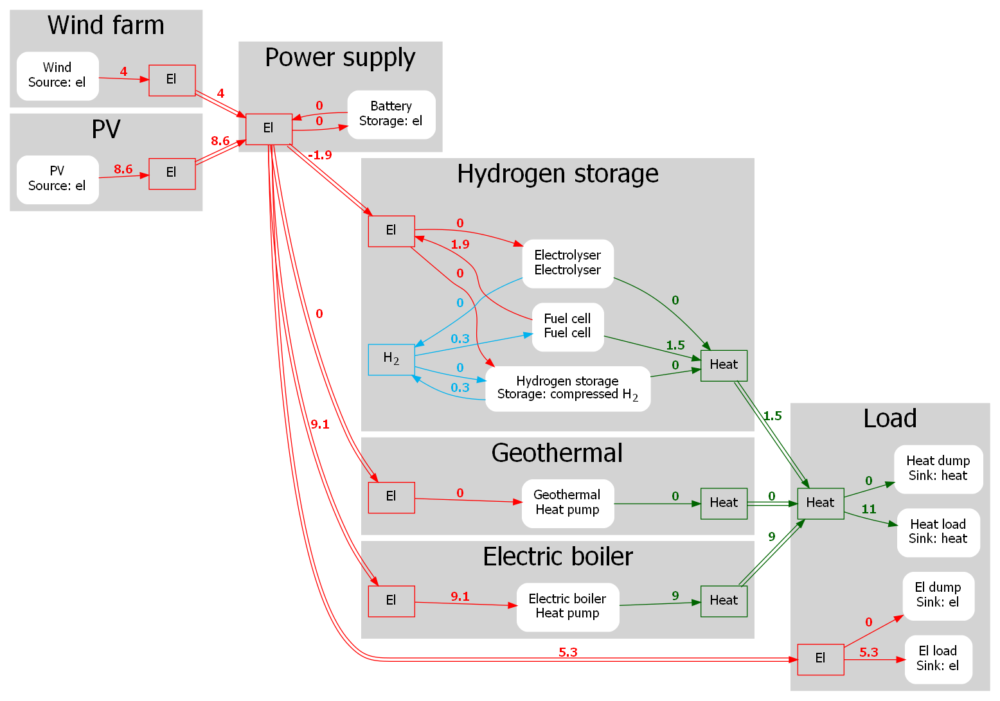

In [18]:
tstep=2191
gCombined = plots.plot_network(simulator=simulator,timestep=tstep,numberformat="{:.3g}", rank_direction="LR",
                              filename=None,only_carrier=None,node_fs=30, dev_fs=15, edge_fs = 14, carrier_fs=15,fn = "DejaVu Sans", names = pretty_name_dict, exclude=dieseldevices,
                              hide_losses=True)
#gCombined.write_pdf(path=outpath+"diagram{}.pdf".format(case))
IPython.display.Image(gCombined.create_png())
#gCombined.write_png(path=outpath+"diagram{}.pdf".format(case),f="pdf")

In [19]:
combine = None
if incl_diesel: combine = [["diesel_generators"],[dieselgenerators]]

fig2=plots.plot_sum_power_mix(sim_result,simulator.optimiser,carrier="el",filename=None,devs_combine=combine,exclude_zero=True,dev_color_dict=device_color_dict)#,devs_shareload=dieselgenerators, exclude_zero=True)#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutputel{}x.pdf".format(case),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

In [20]:
combine = None
if incl_diesel: combine = [["diesel_boilers", "diesel_generators"],[dieselboilers, dieselgenerators]]

fig2=plots.plot_sum_power_mix(sim_result,simulator.optimiser,carrier="heat",filename=None,devs_combine=combine,exclude_zero=True,dev_color_dict=device_color_dict)#,devs_shareload=dieselgenerators, exclude_zero=True)#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutputheat{}x.pdf".format(case),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

In [21]:
plots.plotter="plotly"
devices = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["dieselgenerator", "source_el"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=devices,filename=None,include_on_off=True, include_prep=False,devs_shareload=None)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white",
                 title="Power supply and on/off status (case: {})".format(case))
fig.show()

In [22]:
plots.plotter="plotly"
devices = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["dieselheater", "heatpump"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=devices,carrier="heat",filename=None,include_on_off=True, include_prep=False,devs_shareload=None)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white",yaxis_title="Heat supply (MW)",
                 title="Heat supply and on/off status (case: {})".format(case))
fig.show()

,el,heat
device,,
backup_east_1,0.000000,0.000000
backup_east_2,0.000000,0.000000
backup_east_3,0.000000,0.000000
backup_west_1,0.000000,0.000000
backup_west_2,0.000000,0.000000
backup_west_3,0.000000,0.000000
boiler_houses,0.000000,0.000000
diesel_boiler_1,0.000000,0.000000
diesel_boiler_2,0.000000,0.000000


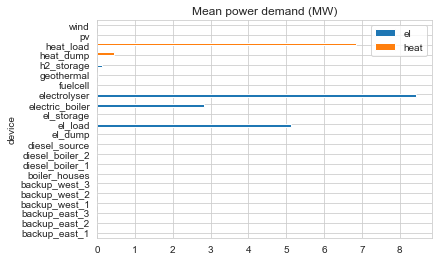

In [23]:
mean_el_demand = sim_result.device_flow.unstack('carrier')['el'].unstack('terminal')['in'].dropna().unstack().T.mean()
mean_heat_demand = sim_result.device_flow.unstack('carrier')['heat'].unstack('terminal')['in'].dropna().unstack().T.mean()
energydemand = pd.concat({'el':mean_el_demand,'heat':mean_heat_demand},axis=1)
#energydemand.drop('heatdump',inplace=True)
energydemand.plot.barh(title="Mean power demand (MW)")
energydemand

In [24]:
energydemand.sum()

el      16.519892
heat     7.301531
dtype: float64

In [25]:
mean_flows=sim_result.device_flow.unstack(["carrier","device","terminal"]).mean().unstack(["carrier","terminal"])
print("Mean flows:\n",mean_flows.sum())
print("Mean flow per device:")
mean_flows

Mean flows:
 carrier   terminal
diesel    in           0.000000
          out          0.000000
el        in          16.519892
          out         16.519892
heat      in           7.301531
          out          7.301531
hydrogen  in           0.975554
          out          0.975554
dtype: float64
Mean flow per device:


carrier         diesel             el                 heat            \
terminal            in  out        in        out        in       out   
device                                                                 
backup_east_1      0.0  0.0  0.000000   0.000000  0.000000  0.000000   
backup_east_2      0.0  0.0  0.000000   0.000000  0.000000  0.000000   
backup_east_3      0.0  0.0  0.000000   0.000000  0.000000  0.000000   
backup_west_1      0.0  0.0  0.000000   0.000000  0.000000  0.000000   
backup_west_2      0.0  0.0  0.000000   0.000000  0.000000  0.000000   
backup_west_3      0.0  0.0  0.000000   0.000000  0.000000  0.000000   
boiler_houses      0.0  0.0  0.000000   0.000000  0.000000  0.000000   
diesel_boiler_1    0.0  0.0  0.000000   0.000000  0.000000  0.000000   
diesel_boiler_2    0.0  0.0  0.000000   0.000000  0.000000  0.000000   
diesel_source      0.0  0.0  0.000000   0.000000  0.000000  0.000000   
el_dump            0.0  0.0  0.000000   0.000000  0.000000  0.000000   
el_load            0.0  0.0  5.121251   0.000000  0.000000  0.000000   
el_storage         0.0  0.0  0.000645   0.000107  0.000000  0.000000   
electric_boiler    0.0  0.0  2.836013   0.000000  0.000000  2.807653   
electrolyser       0.0  0.0  8.429748   0.000000  0.000000  1.938842   
fuelcell           0.0  0.0  0.000000   3.117912  0.000000  2.494329   
geothermal         0.0  0.0  0.011267   0.000000  0.000000  0.045067   
h2_storage         0.0  0.0  0.120968   0.000000  0.000000  0.015640   
heat_dump          0.0  0.0  0.000000   0.000000  0.445832  0.000000   
heat_load          0.0  0.0  0.000000   0.000000  6.855699  0.000000   
pv                 0.0  0.0  0.000000   1.841265  0.000000  0.000000   
wind               0.0  0.0  0.000000  11.560608  0.000000  0.000000   

carrier          hydrogen            
terminal               in       out  
device                               
backup_east_1    0.000000  0.000000  
backup_east_2    0.000000  0.000000  
backup_east_3    0.000000  0.000000  
backup_west_1    0.000000  0.000000  
backup_west_2    0.000000  0.000000  
backup_west_3    0.000000  0.000000  
boiler_houses    0.000000  0.000000  
diesel_boiler_1  0.000000  0.000000  
diesel_boiler_2  0.000000  0.000000  
diesel_source    0.000000  0.000000  
el_dump          0.000000  0.000000  
el_load          0.000000  0.000000  
el_storage       0.000000  0.000000  
electric_boiler  0.000000  0.000000  
electrolyser     0.000000  0.484545  
fuelcell         0.491010  0.000000  
geothermal       0.000000  0.000000  
h2_storage       0.484545  0.491010  
heat_dump        0.000000  0.000000  
heat_load        0.000000  0.000000  
pv               0.000000  0.000000  
wind             0.000000  0.000000

In [26]:
plots.plotter="plotly"
gts = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["sourceel"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=gts,filename=None,include_on_off=False,include_prep=False,devs_shareload=None)
#fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.show()
#300 dpi and 4 inch: 1200 pixels
scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"powersupply.pdf",width=700,height=300,scale=scale)

In [27]:
dfStartopt = pd.DataFrame()
inst=simulator.optimiser
for t in inst.setHorizon: 
    if incl_wind: dfStartopt.loc[t,'start']=inst.varDeviceStarting['wind',t].value
    if incl_geothermal: dfStartopt.loc[t,'prep']=inst.varDeviceIsPrep['geothermal',t].value
    if incl_hydrogen: 
        dfStartopt.loc[t,'on']=inst.varDeviceIsOn['electrolyser',t].value
        dfStartopt.loc[t,'stop']=inst.varDeviceStopping['fuelcell',t].value
dfStartopt.head()

,start,prep,on,stop
0,NaN,0.0,1.0,NaN
1,NaN,0.0,1.0,NaN
2,NaN,0.0,1.0,NaN
3,NaN,0.0,1.0,NaN
4,NaN,0.0,1.0,NaN


In [28]:
plots.plotter="plotly"
if 'el_storage' in simulator.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,'el_storage',filename=None,dev_color_dict=device_color_dict)#outpath+"battery_opt.png")
    fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
#    oogeso.plots.optimization_plots.plot_device_power_last_optimisation_1(mc,device='battery', filename=None)#outpath+"lastopt_battery.png")

In [29]:
plots.plotter="plotly"
if incl_hydrogen:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,hydrogenstorage[0],filename=None,dev_color_dict=device_color_dict)#outpath+"battery_opt.png")
    #fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
    fig.show()

In [30]:
plots.plotter="plotly"
fig=plots.plot_CO2_rate_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt.png",dev_color_dict=device_color_dict)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [31]:
plots.plotter="plotly"
combine = None
if incl_diesel: combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselboilers]]

fig=plots.plot_CO2_rate_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",devs_combine=combine,dev_color_dict=device_color_dict)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [32]:
fig = plots.plot_CO2_rate(sim_result)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [33]:
fig = plots.plot_op_cost(sim_result)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [34]:
plots.plotter="plotly"
combine = None
exclude = dumpdevices + loaddevices 

fig=plots.plot_op_cost_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",devs_combine=combine,devs_exclude=exclude,dev_color_dict=device_color_dict)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [35]:
plots.plotter="plotly"
combine = None
if incl_diesel: combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselboilers]]
exclude = dumpdevices + loaddevices 

fig=plots.plot_op_cost_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",devs_combine=combine,devs_exclude=exclude,dev_color_dict=device_color_dict)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [36]:
fig = plots.plot_all_costs(sim_result, simulator.optimiser)
fig.show()

In [37]:
exclude = dumpdevices + loaddevices 

fig = plots.plot_all_costs_per_device(sim_result, simulator.optimiser, include_sum=True, devs_exclude=exclude)
fig.show()

0.0


In [38]:
if incl_diesel: combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselboilers]]
exclude = dumpdevices + loaddevices 

fig = plots.plot_all_costs_per_device(sim_result, simulator.optimiser, include_sum=True, devs_combine=combine, devs_exclude=exclude)
fig.show()

0.0


In [39]:
sim_result.co2_rate

0       0.0
1       0.0
2       0.0
3       0.0
4       0.0
       ... 
8515    0.0
8516    0.0
8517    0.0
8518    0.0
8519    0.0
Length: 8520, dtype: float64

In [40]:
plots.plotter="plotly"
fig=plots.plot_reserve(sim_result,simulator.optimiser,dynamic_margin=True,include_sum=False,dev_color_dict=device_color_dict)
#plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
#fig.set_size_inches(5.92,1.5)
#plt.savefig("result/reserve{}x.pdf".format(case),dpi=300,bbox_inches="tight")
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [41]:
plots.plotter="plotly"
combine = [["diesel_generators"],[dieselgenerators]]

fig=plots.plot_reserve(sim_result,simulator.optimiser,dynamic_margin=True,include_sum=False,devs_combine=combine,dev_color_dict=device_color_dict)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [42]:
plots.plotter="plotly"
fig=plots.plot_reserve(sim_result,simulator.optimiser,carrier="heat",dynamic_margin=True,include_sum=False,dev_color_dict=device_color_dict)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()

In [43]:
plots.plotter="plotly"
combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselboilers]]

fig=plots.plot_reserve(sim_result,simulator.optimiser,carrier="heat",dynamic_margin=True,include_sum=False,devs_combine=combine,dev_color_dict=device_color_dict)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()

In [44]:
# This plot shows per device its output (dotted line) and the available online backup, iel reserve 
# by _other_ devices (solid line). MARGIN(t) = min_devices(backup(t) - output(t))
plots.plot_el_backup(sim_result,show_margin=True,return_margin=False)

In [45]:
if incl_hydrogen:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,"h2_storage")
    fig.update_layout(autosize=False,width=800,height=250,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
    fig.update_yaxes(tick0=0, dtick=1,secondary_y=True,range=[0,5.5])
    fig.update_yaxes(tick0=0, dtick=100e3,secondary_y=False,range=[0,550e3])
    fig.show()
    fig.write_image(outpath+"h2_storage{}.pdf".format(case))

In [46]:
sim_result.el_backup.unstack("device")

device,backup_east_1,backup_east_2,backup_east_3,backup_west_1,backup_west_2,backup_west_3,el_storage,fuelcell,pv,wind
time,,,,,,,,,,
0,20.231373,20.231373,20.231373,20.231373,20.231373,20.231373,14.231373,6.0,20.231373,20.231373
1,18.006311,18.006311,18.006311,18.006311,18.006311,18.006311,12.006311,6.0,18.006311,18.006311
2,15.804751,15.804751,15.804751,15.804751,15.804751,15.804751,9.804751,6.0,15.804751,15.804751
3,15.005832,15.005832,15.005832,15.005832,15.005832,15.005832,9.005832,6.0,15.005832,15.005832
4,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,15.000000,6.0,21.000000,21.000000
...,...,...,...,...,...,...,...,...,...,...
8515,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,15.000000,6.0,21.000000,21.000000
8516,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,15.000000,6.0,21.000000,21.000000
8517,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,15.000000,6.0,21.000000,21.000000


In [47]:
simulator.profiles["nowcast"]

,el_load,heat_load,V47,V105,PV,geothermal
0,4.73,9.488144,0.326000,0.249744,0.0,1.0
1,4.12,9.581248,0.221897,0.162033,0.0,1.0
2,4.46,9.522000,0.120876,0.090527,0.0,1.0
3,4.38,9.225760,0.069881,0.055285,0.0,1.0
4,4.43,8.963376,0.451660,0.381192,0.0,1.0
...,...,...,...,...,...,...
8755,5.26,10.139872,0.029887,0.033634,0.0,1.0
8756,5.16,9.826704,0.019165,0.019081,0.0,1.0
8757,5.12,9.640496,0.000000,0.000166,0.0,1.0
8758,4.99,9.513536,0.035914,0.030137,0.0,1.0


In [48]:
if incl_wind or incl_pv:
    fig = plots.plot_unused_profile_power(simulator)
    fig.show()